# EDA

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
import plotly.express as px
import calendar

from matplotlib.ticker import FuncFormatter
from shapely.geometry import Point, Polygon

In [5]:
#import os, sys
#sys.path.insert(0, os.path.abspath("../.."))

In [2]:
from src.utils import eda

In [3]:
data = pd.read_csv('../../data/Food_Inspections.csv')

In [4]:
data.head()

,Inspection ID,DBA Name,AKA Name,License #,Facility Type,Risk,Address,City,State,Zip,Inspection Date,Inspection Type,Results,Violations,Latitude,Longitude,Location
0,2453552,CLAMP DOWN BURGERS,NaN,2749943.0,NaN,Risk 2 (Medium),1742 W DIVISION ST,CHICAGO,IL,60622.0,10/20/2020,License,No Entry,NaN,41.903387,-87.671740,"(-87.67174026586648, 41.903386755553484)"
1,2386633,JIN JU,JIN JU,27137.0,Restaurant,Risk 1 (High),5203 N CLARK ST,CHICAGO,IL,60640.0,08/28/2020,Canvass,No Entry,NaN,41.976301,-87.668276,"(-87.66827593789948, 41.97630115368914)"
2,2386595,LA BIZNAGA #2,LA BIZNAGA #2,2708992.0,NaN,Risk 1 (High),2949 W BELMONT AVE,CHICAGO,IL,60618.0,08/27/2020,Complaint,No Entry,NaN,41.939256,-87.702270,"(-87.70226967930802, 41.939255926667535)"
3,2386464,Uni Sushi Bristo,Uni Sushi Bistro,2262637.0,Restaurant,Risk 1 (High),1752 W NORTH AVE,CHICAGO,IL,60622.0,08/25/2020,Complaint,No Entry,NaN,41.910676,-87.672205,"(-87.67220465807979, 41.91067561170382)"
4,2386398,KIKI'S BISTRO,KIKI'S BISTRO,22899.0,Restaurant,Risk 1 (High),900 N FRANKLIN ST,CHICAGO,IL,60610.0,08/24/2020,Canvass,No Entry,NaN,41.898998,-87.635921,"(-87.63592067312285, 41.89899799424835)"


In [5]:
len(data)

215067

**Al día 15 de enero de 2021 contamos con 215,067 datos**

In [6]:
data.columns

Index(['Inspection ID', 'DBA Name', 'AKA Name', 'License #', 'Facility Type',
       'Risk', 'Address', 'City', 'State', 'Zip', 'Inspection Date',
       'Inspection Type', 'Results', 'Violations', 'Latitude', 'Longitude',
       'Location'],
      dtype='object')

Los tipos de dato que tiene cada variable inicialmente son:

In [7]:
data.dtypes

Inspection ID        int64
DBA Name            object
AKA Name            object
License #          float64
Facility Type       object
Risk                object
Address             object
City                object
State               object
Zip                float64
Inspection Date     object
Inspection Type     object
Results             object
Violations          object
Latitude           float64
Longitude          float64
Location            object
dtype: object

Cambiamos el formato de las columnas

In [9]:
def clean_column(col):
    """ Replace column's spaces and slash with underscore"""
    return col.lower()\
              .replace('/','_')\
              .replace(' ','_')

In [10]:
data.rename(columns={col: clean_column(col) for col in data.columns.values}, inplace=True)

## Profiling general con los datos en crudo

In [11]:
eda.genera_profiling_general(data)

El dataframe tiene 17 columnas.
Hay 12 columnas que tienen NA's.


,Estadísticas,Resultado
0,Total de variables,17
1,Conteo de observaciones,215067
2,Total de celdas,3656139
3,Cantidad de variables numéricas,5
4,Cantidad de variables de fecha,0
5,Cantidad de variables categóricas,0
6,Cantidad de variables de texto,12
7,Valores faltantes,67276
8,Porcentaje de valores faltantes,1.8%
9,Renglones duplicados,0


En la base de datos tenemos 67,276 elementos faltantes, distribuidos de la siguiente forma:

In [12]:
eda.cuenta_nulos_por_columnas(data)

El dataframe tiene 17 columnas.
Hay 12 columnas que tienen NA's.


,Missing Values,% del Total
violations,57424,26.7
facility_type,4889,2.3
aka_name,2486,1.2
latitude,710,0.3
longitude,710,0.3
location,710,0.3
city,158,0.1
risk,69,0.0
zip,52,0.0
state,50,0.0


Cambiamos tipos de datos

In [13]:
data = data.astype({"facility_type":'category',
                    "risk":'category', 
                    "city":'category', 
                    "state":'category', 
                    "zip":'category',
                    "inspection_type":'category',
                    "results":'category', 
                    "inspection_id":'str',
                    "license_#":'str'})
data['inspection_date'] = pd.to_datetime(data['inspection_date'], dayfirst=True)

Generamos profiling por tipo de variable

In [14]:
profiling_numericas, profiling_categoricas, profiling_texto,profiling_fechas = \
eda.genera_profiling_por_variable(data)

In [15]:
profiling_numericas

,Métrica,latitude,longitude
0,Tipo,float64,float64
1,Número de observaciones,214357.00,214357.00
2,Media,41.88,-87.68
3,Desviación estándar,0.08,0.06
4,Cuartil 25%,41.83,-87.71
5,Cuartil 50%,41.89,-87.67
6,Cuartil 75%,41.94,-87.63
7,Mínimo,41.64,-87.91
8,Máximo,42.02,-87.53
9,Número de observaciones únicas,17246,17246


Del perfilamiento de las variables numéricas podemos apreciar lo siguiente:
- No hay valores atípicos en los registros.
- Existen 710 registros con valores faltantes para `latitude` y `longitude`.

In [16]:
profiling_categoricas

,Métrica,facility_type,risk,city,state,zip,inspection_type,results
0,Tipo,category,category,category,category,category,category,category
1,Número de categorías,500,4,70,4,112,110,7
2,Número de observaciones,215067,215067,215067,215067,215067,215067,215067
3,Observaciones nulas,4889,69,158,50,52,1,0
4,% Observaciones nulas,0.022732,0.000321,0.000735,0.000232,0.000242,0.000005,0.0
5,Valores únicos,"[nan, Restaurant, Children's Services Facility...","[Risk 2 (Medium), Risk 1 (High), Risk 3 (Low),...","[CHICAGO, Chicago, ELMHURST, CHICAGO., WILMETT...","[IL, nan, IN, NY, WI]","[60622.0, 60640.0, 60618.0, 60610.0, 60607.0, ...","[License, Canvass, Complaint, Canvass Re-Inspe...","[No Entry, Pass, Out of Business, Fail, Pass w..."
6,Moda1/veces/%,"[Restaurant, 143,207, 68.14%]","[Risk 1 (High), 153,815, 71.54%]","[CHICAGO, 214,166, 99.65%]","[IL, 215,014, 100.0%]","[60614.0, 8,133, 3.78%]","[Canvass, 114,224, 53.11%]","[Pass, 112,619, 52.36%]"
7,Moda2/veces/%,"[Grocery Store, 28,084, 13.36%]","[Risk 2 (Medium), 41,971, 19.52%]","[Chicago, 345, 0.16%]","[IN, 1, 0.0%]","[60647.0, 7,828, 3.64%]","[License, 28,292, 13.16%]","[Fail, 41,511, 19.3%]"
8,Moda3/veces/%,"[School, 13,206, 6.28%]","[Risk 3 (Low), 19,184, 8.92%]","[chicago, 111, 0.05%]","[NY, 1, 0.0%]","[60657.0, 7,485, 3.48%]","[Canvass Re-Inspection, 22,824, 10.61%]","[Pass w/ Conditions, 32,540, 15.13%]"


Del perfilamiento de las variables categóricas podemos apreciar lo siguiente:
- En la variable `city` el valor `chicago` está escrito de distintas formas, se tendrá que estandarizar el formato.
- En la variable `state` parece existir errores de captura, pues de acuerdo a las coordenadas vistas previamente esperaríamos que todos los valores fueran `IL` (Illinois).

In [17]:
profiling_texto

,Métrica,inspection_id,dba_name,aka_name,license_#,address,violations,location
0,Tipo,object,object,object,object,object,object,object
1,Número de observaciones,215067,215067,215067,215067,215067,215067,215067
2,Observaciones únicas,215067,28748,27355,39104,18522,156694,17246
3,% Observaciones únicas,1.000000,0.133670,0.127193,0.181822,0.086122,0.728582,0.080189
4,Tamaño promedio,6.793674,18.656349,17.908534,8.530625,18.583734,1235.425290,39.075160
5,Tamaño mínimo,5,1,2.000000,3,1,30.000000,34.000000
6,Tamaño máximo,7,79,79.000000,9,40,11620.000000,40.000000


Del perfilamiento de las variables de texto podemos apreciar lo siguiente:
- La variable `inspection_id` es la única que tiene valores únicos para cada registro.
- En los 215,067 registros totales sólo se tienen 28,748 nombres de negocios (`dba_name`), lo que nos indica que existen negocios repetidos en los registros probablemente con fechas de inspección distintas.

In [18]:
profiling_fechas

,Métrica,inspection_date
0,Tipo,datetime64[ns]
1,Número de observaciones,215067
2,Mínimo,2010-01-02 00:00:00
3,Máximo,2021-12-01 00:00:00
4,Número de observaciones únicas,2796
5,Número de faltantes,0
6,Top1/veces/%,"[2013-11-14 00:00:00, 185, 0.09%]"
7,Top2/veces/%,"[2016-09-13 00:00:00, 149, 0.07%]"
8,Top3/veces/%,"[2016-11-29 00:00:00, 145, 0.07%]"


Del perfilamiento de las variables de fecha podemos apreciar lo siguiente:
- Contamos con datos del 1 de febrero de 2010 al 12 de enero de 2021.
- El intervalo mencionado previamente equivale a 3,999 días. Sin embargo, sólo se tiene registro de 2,796 días distintos.

## Permilamiento general haciendo limpieza de datos

Cambiamos tipos de variable para poder estandarizar el formato

In [19]:
data = data.astype({"facility_type":'str',
                    "risk":'str', 
                    "city":'str', 
                    "state":'str', 
                    "zip":'str',
                    "inspection_type":'str',
                    "results":'str'})

In [20]:
eda.EstandarizaFormato(data)

,inspection_id,dba_name,aka_name,license_#,facility_type,risk,address,city,state,zip,inspection_date,inspection_type,results,violations,latitude,longitude,location
0,2453552,clamp down burgers,NaN,2749943.0,NaN,risk 2 (medium),1742 w division st,chicago,il,60622.0,2020-10-20,license,no entry,NaN,41.903387,-87.671740,"(-87.67174026586648, 41.903386755553484)"
1,2386633,jin ju,jin ju,27137.0,restaurant,risk 1 (high),5203 n clark st,chicago,il,60640.0,2020-08-28,canvass,no entry,NaN,41.976301,-87.668276,"(-87.66827593789948, 41.97630115368914)"
2,2386595,la biznaga #2,la biznaga #2,2708992.0,NaN,risk 1 (high),2949 w belmont ave,chicago,il,60618.0,2020-08-27,complaint,no entry,NaN,41.939256,-87.702270,"(-87.70226967930802, 41.939255926667535)"
3,2386464,uni sushi bristo,uni sushi bistro,2262637.0,restaurant,risk 1 (high),1752 w north ave,chicago,il,60622.0,2020-08-25,complaint,no entry,NaN,41.910676,-87.672205,"(-87.67220465807979, 41.91067561170382)"
4,2386398,kiki's bistro,kiki's bistro,22899.0,restaurant,risk 1 (high),900 n franklin st,chicago,il,60610.0,2020-08-24,canvass,no entry,NaN,41.898998,-87.635921,"(-87.63592067312285, 41.89899799424835)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
215062,229233,"zullo's markets, llc",zullo's market,2016915.0,restaurant,risk 2 (medium),131 n clinton st,chicago,il,60661.0,2010-02-18,license,fail,NaN,41.884188,-87.641120,"(-87.64111966683218, 41.884187507127805)"
215063,68205,la fonda chiquita tlc,la fonda chiquita,2017215.0,restaurant,risk 1 (high),5940 w diversey ave,chicago,il,60639.0,2010-09-02,license,fail,12. hand washing facilities: with soap and san...,41.931260,-87.775203,"(-87.77520287598688, 41.93125971874477)"
215064,88234,kabab cuisine 2,kabab cuisine 2,2014076.0,restaurant,risk 1 (high),6320 n lincoln ave,chicago,il,60659.0,2010-01-02,license re-inspection,pass,NaN,41.996139,-87.716968,"(-87.71696834498202, 41.996139331170895)"
215065,74311,margarita distributors,NaN,2017298.0,wholesale,risk 3 (low),2332 s blue island ave bldg,chicago,il,60608.0,2010-02-19,license re-inspection,pass,NaN,41.849940,-87.672421,"(-87.67242100722251, 41.84994008002549)"


Y volvemos a crear el profiling general

In [21]:
data = data.astype({"facility_type":'category',
                    "risk":'category', 
                    "city":'category', 
                    "state":'category', 
                    "zip":'category',
                    "inspection_type":'category',
                    "results":'category'})

In [22]:
profiling_numericas, profiling_categoricas, profiling_texto,profiling_fechas = \
eda.genera_profiling_por_variable(data)

Sólo nos interesa revisar el perfilamiento de variables categóricas y de texto, pues son las que se vieron afectadas con la estandarización de formato

In [23]:
profiling_categoricas

,Métrica,facility_type,risk,city,state,zip,inspection_type,results
0,Tipo,category,category,category,category,category,category,category
1,Número de categorías,448,4,65,4,112,98,7
2,Número de observaciones,215067,215067,215067,215067,215067,215067,215067
3,Observaciones nulas,4889,69,158,50,52,1,0
4,% Observaciones nulas,0.022732,0.000321,0.000735,0.000232,0.000242,0.000005,0.0
5,Valores únicos,"[nan, restaurant, children's services facility...","[risk 2 (medium), risk 1 (high), risk 3 (low),...","[chicago, elmhurst, chicago., wilmette, maywoo...","[il, nan, in, ny, wi]","[60622.0, 60640.0, 60618.0, 60610.0, 60607.0, ...","[license, canvass, complaint, canvass re-inspe...","[no entry, pass, out of business, fail, pass w..."
6,Moda1/veces/%,"[restaurant, 143,207, 68.14%]","[risk 1 (high), 153,815, 71.54%]","[chicago, 214,636, 99.87%]","[il, 215,014, 100.0%]","[60614.0, 8,133, 3.78%]","[canvass, 114,225, 53.11%]","[pass, 112,619, 52.36%]"
7,Moda2/veces/%,"[grocery store, 28,088, 13.36%]","[risk 2 (medium), 41,971, 19.52%]","[cchicago, 48, 0.02%]","[in, 1, 0.0%]","[60647.0, 7,828, 3.64%]","[license, 28,294, 13.16%]","[fail, 41,511, 19.3%]"
8,Moda3/veces/%,"[school, 13,219, 6.29%]","[risk 3 (low), 19,184, 8.92%]","[schaumburg, 27, 0.01%]","[ny, 1, 0.0%]","[60657.0, 7,485, 3.48%]","[canvass re-inspection, 22,824, 10.61%]","[pass w/ conditions, 32,540, 15.13%]"


Apreciamos las modificaciones siguientes:
- Se redujeron el número de categorías en `facility_type`, `city`, e `inspection_type`.
- Apesar de que se corrigieron las diferencias entre mayúsculas y minúsculas para el valor `chicago` en la variable `city`, se nota que existen errores de captura como `cchicago`.

In [24]:
profiling_texto

,Métrica,inspection_id,dba_name,aka_name,license_#,address,violations,location
0,Tipo,object,object,object,object,object,object,object
1,Número de observaciones,215067,215067,215067,215067,215067,215067,215067
2,Observaciones únicas,215067,28334,26943,39104,18364,155199,17246
3,% Observaciones únicas,1.000000,0.131745,0.125277,0.181822,0.085387,0.721631,0.080189
4,Tamaño promedio,6.793674,18.633607,17.883132,8.530625,17.581614,1230.981579,39.075160
5,Tamaño mínimo,5,1,2.000000,3,0,30.000000,34.000000
6,Tamaño máximo,7,79,79.000000,9,39,11587.000000,40.000000


Apreciamos las modificaciones siguientes:
- Sin contar la variable `inspection_id`, en general se redujeron el número de observaciones únicas en las variables.

Creamos tablas de conteo y porcentaje para las variables `risk`y `results`

In [25]:
eda.CreaTablaConteoPorcentaje(data, "risk", False)

,risk,porcentaje
risk 1 (high),"153,815",71.52%
risk 2 (medium),"41,971",19.52%
risk 3 (low),"19,184",8.92%
NaN,69,0.03%
all,28,0.01%


In [26]:
data.loc[data["risk"] == "all"]

,inspection_id,dba_name,aka_name,license_#,facility_type,risk,address,city,state,zip,inspection_date,inspection_type,results,violations,latitude,longitude,location
4629,2463686,salty sweet,NaN,2762610.0,NaN,all,4459 w armitage ave,chicago,il,60639.0,2020-11-12,license,not ready,NaN,41.916908,-87.738716,"(-87.73871647422581, 41.91690825890332)"
19485,2356761,footman hospitality 15 ww llc,NaN,2708627.0,NaN,all,15 w washington st,chicago,il,60602.0,2020-01-15,license,no entry,NaN,41.883109,-87.628467,"(-87.62846686342625, 41.883108620702494)"
20583,2346119,mikkey's hyde park,mikkey's hyde park,2631127.0,NaN,all,5319 s hyde park blvd,chicago,il,60615.0,2019-11-21,canvass,out of business,NaN,41.799003,-87.583893,"(-87.58389265837322, 41.799003255757576)"
23939,2355739,lo' down dirty vegan,lo' down dirty vegan,2708573.0,NaN,all,225 e 47th st,chicago,il,60653.0,2019-12-20,license,not ready,NaN,41.809219,-87.620035,"(-87.62003481112403, 41.80921877834854)"
24689,2303377,taco bell #35850,taco bell,2665149.0,restaurant,all,22 e chicago ave,chicago,il,60611.0,2019-07-18,canvass,out of business,NaN,41.896799,-87.627266,"(-87.62726628946932, 41.89679861905508)"
28085,2312632,supermercado el paraiso inc.,supermercado el paraiso inc.,2670414.0,grocery store,all,4301 s archer ave,chicago,il,60632.0,2019-09-20,canvass,out of business,NaN,41.815301,-87.702042,"(-87.70204160078063, 41.81530069366088)"
28515,2300322,taco bell #35850,taco bell,2665149.0,restaurant,all,22 e chicago ave,chicago,il,60611.0,2019-06-27,license,not ready,NaN,41.896799,-87.627266,"(-87.62726628946932, 41.89679861905508)"
29227,2291008,supermercado el paraiso inc.,supermercado el paraiso inc.,2670414.0,grocery store,all,4301 s archer ave,chicago,il,60632.0,2019-06-06,license,not ready,NaN,41.815301,-87.702042,"(-87.70204160078063, 41.81530069366088)"
31097,2300306,starbucks,starbucks,2671667.0,restaurant,all,303 e superior st,chicago,il,60611.0,2019-06-26,license,not ready,NaN,41.895692,-87.620143,"(-87.62014286048188, 41.895692401410514)"
34133,2268498,mikkey's hyde park,mikkey's hyde park,2631127.0,NaN,all,5319 s hyde park blvd,chicago,il,60615.0,2019-02-25,license,not ready,NaN,41.799003,-87.583893,"(-87.58389265837322, 41.799003255757576)"


In [27]:
eda.CreaTablaConteoPorcentaje(data, "results", False)

,results,porcentaje
pass,"112,619",52.36%
fail,"41,511",19.3%
pass w/ conditions,"32,540",15.13%
out of business,"18,706",8.7%
no entry,"7,332",3.41%
not ready,"2,287",1.06%
business not located,72,0.03%


In [28]:
data['results'] = data['results'].str.replace('w/ ', 'w_')

# GEDA

In [29]:
def number_formatter(number, pos=None):
    """Convert a number into a human readable format."""
    magnitude = 0
    while abs(number) >= 1000:
        magnitude += 1
        number /= 1000
    return '%d%s' % (number, ['', 'K', 'M', 'B', 'T', 'Q'][magnitude])

In [30]:
risk_colors = ["darkred", "orange", "green", "gray", "blue"]
risk_Palette = sns.set_palette(sns.color_palette(risk_colors))
risk_order = ["risk 1 (high)", "risk 2 (medium)", "risk 3 (low)", "nan", "all"]

In [31]:
risk = pd.DataFrame(data['risk'].value_counts())
risk = risk.rename(columns = {'risk':'counts'})
risk

,counts
risk 1 (high),153815
risk 2 (medium),41971
risk 3 (low),19184
all,28


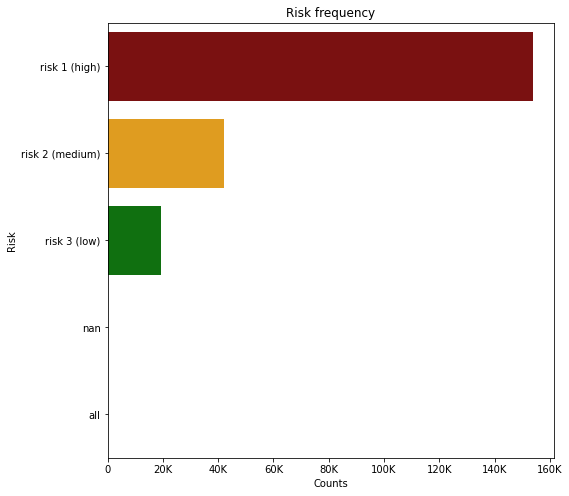

In [32]:
plt.figure(figsize=(8,8)) 
ax = sns.barplot(x="counts", 
                 y=risk.index, 
                 data=risk,
                 order=risk_order,
                 palette=risk_colors)
ax.set(title='Risk frequency',
       xlabel='Counts',
       ylabel='Risk')
ax.xaxis.set_major_formatter(FuncFormatter(number_formatter))
plt.show()

In [33]:
results = pd.DataFrame(data['results'].value_counts())
results = results.rename(columns = {'results':'counts'})
results

,counts
pass,112619
fail,41511
pass w_conditions,32540
out of business,18706
no entry,7332
not ready,2287
business not located,72


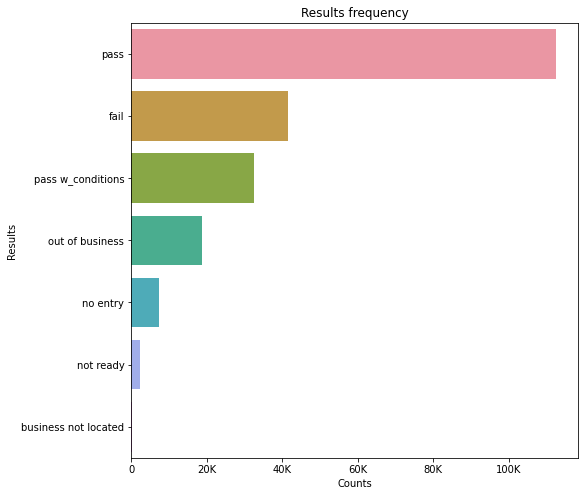

In [34]:
plt.figure(figsize=(8,8)) 
ax = sns.barplot(x="counts", 
                 y=results.index, 
                 data=results) 
ax.set(title='Results frequency',
       xlabel='Counts',
       ylabel='Results')
ax.xaxis.set_major_formatter(FuncFormatter(number_formatter))
plt.show()

In [35]:
results_risk = data.groupby(['results', 'risk'], as_index=False).size()

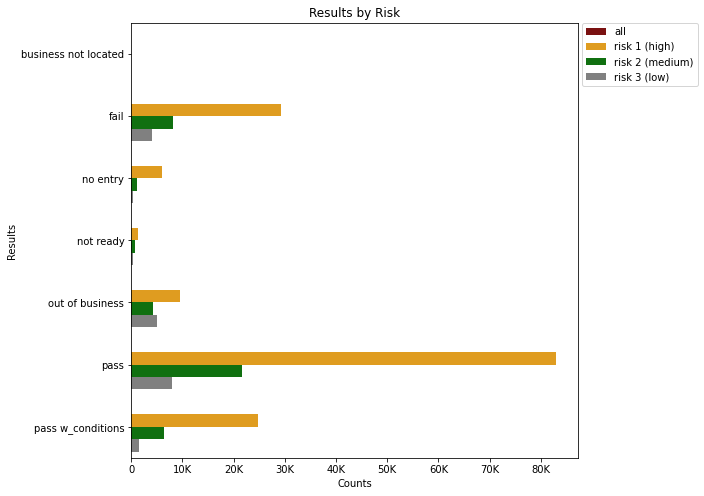

In [36]:
plt.figure(figsize=(8, 8)) 
ax = sns.barplot(y="results", 
                 x="size", 
                 data=results_risk, 
                 hue="risk",
                 palette=risk_Palette)
ax.set(title='Results by Risk',
       xlabel='Counts',
       ylabel='Results')
ax.xaxis.set_major_formatter(FuncFormatter(number_formatter))
ax.legend(bbox_to_anchor=(1.01, 1),
          loc = 'upper left',
          borderaxespad = 0)
plt.show()

Para un mejor análisis de nuestros datos, crearemos la variable `label` que tomará los siguientes valores:
- `pass` para registros con valores en `results` iguales a *pass* y *pass with conditions*
- `fail` para registros con valores en `results` iguales a *fail* 
- `other` para registros con valores en `results` iguales a *out of business*, *no entry*, *not ready* y *business not located*

In [37]:
data['label'] = data['results']
data['label'] = data['label'].str.replace('pass w_conditions', 'pass')
data['label'] = data['label'].str.replace('pass', 'pass')
data['label'] = data['label'].str.replace('fail', 'fail')
data['label'] = data['label'].str.replace('out of business', 'other')
data['label'] = data['label'].str.replace('no entry', 'other')
data['label'] = data['label'].str.replace('not ready', 'other')
data['label'] = data['label'].str.replace('business not located', 'other')

In [38]:
label = pd.DataFrame(data['label'].value_counts())
label = label.rename(columns = {'label':'counts'})
label

,counts
pass,145159
fail,41511
other,28397


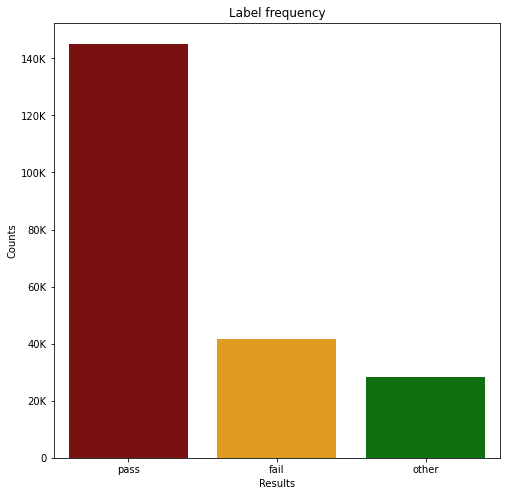

In [39]:
plt.figure(figsize=(8, 8))
ax = sns.barplot(x=label.index,
                 y='counts',
                 data=label)
ax.set(title='Label frequency',
       xlabel='Results',
       ylabel='Counts')
ax.yaxis.set_major_formatter(FuncFormatter(number_formatter))
plt.show()

In [40]:
label_risk = data.groupby(['label', 'risk'], as_index=False).size()
label_risk

,label,risk,size
0,fail,all,5
1,fail,risk 1 (high),29275
2,fail,risk 2 (medium),8078
3,fail,risk 3 (low),4131
4,other,all,23
5,other,risk 1 (high),16730
6,other,risk 2 (medium),5929
7,other,risk 3 (low),5680
8,pass,all,0
9,pass,risk 1 (high),107810


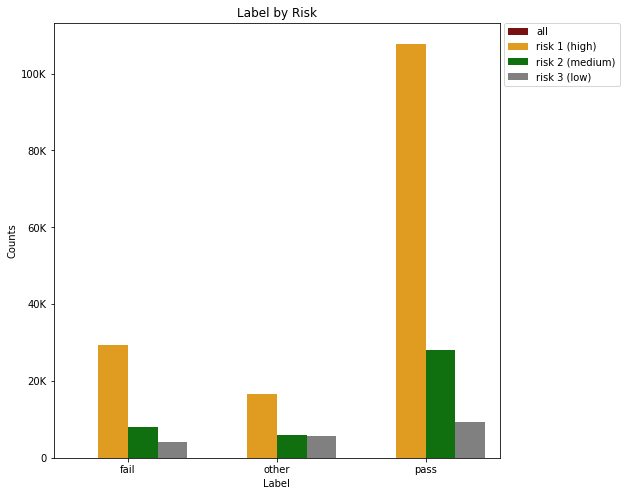

In [41]:
plt.figure(figsize = (8,8)) 
ax = sns.barplot(x = "label", 
                 y = "size", 
                 data = label_risk, 
                 hue = "risk",
                 palette = risk_Palette)
ax.set(title = 'Label by Risk',
       ylabel = 'Counts',
       xlabel = 'Label')
ax.yaxis.set_major_formatter(FuncFormatter(number_formatter))
ax.legend(bbox_to_anchor = (1.01, 1),
          loc = 'upper left',
          borderaxespad = 0)
plt.show()

## Mapa de los  establecimientos

In [42]:
mapa_il = gpd.read_file('chicago_map/chicago_map.shp')

In [43]:
geometry = [Point(xy) for xy in zip(data["longitude"], data["latitude"])]   
geo_df = gpd.GeoDataFrame(data, geometry = geometry)

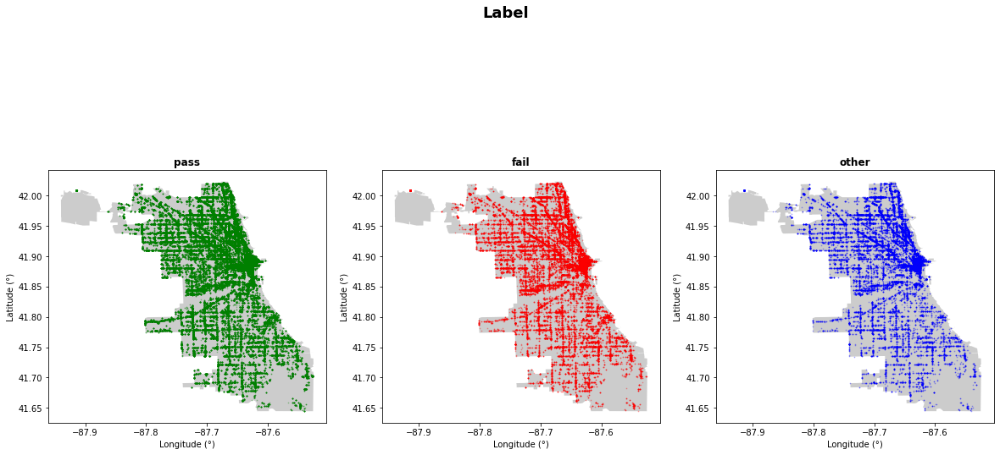

In [44]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(20,10))

mapa_il.plot(ax=axes[0], alpha = 0.4, color = "grey")
geo_df[geo_df['label']=="pass"].plot(ax=axes[0], markersize=0.5, color="green", alpha=0.3)
axes[0].set_title('pass', fontweight = "bold")
axes[0].set_xlabel("Longitude (°)")
axes[0].set_ylabel("Latitude (°)")

mapa_il.plot(ax=axes[1], alpha = 0.4, color = "grey")
geo_df[geo_df['label']=="fail"].plot(ax=axes[1], markersize=0.5, color="red", alpha=0.3)
axes[1].set_title('fail', fontweight = "bold")
axes[1].set_xlabel("Longitude (°)")
axes[1].set_ylabel("Latitude (°)")

mapa_il.plot(ax=axes[2], alpha = 0.4, color = "grey")
geo_df[geo_df['label']=="other"].plot(ax=axes[2], markersize=0.5, color="blue", alpha=0.3)
axes[2].set_title('other', fontweight = "bold")
axes[2].set_xlabel("Longitude (°)")
axes[2].set_ylabel("Latitude (°)")

fig.suptitle("Label", fontweight = "bold", fontsize = 18)
plt.show()

El siguiente mapa esta creado para ser interactivo.

In [45]:
fig = px.scatter_mapbox(data, lat="latitude", lon="longitude", hover_name="dba_name", hover_data=["label"], 
                        color="label", zoom=9, height=600)
fig.update_layout(mapbox_style="open-street-map")
fig.show()

In [46]:
#fig = px.scatter_mapbox(data, lat="latitude", lon="longitude", hover_name="dba_name", 
#                        hover_data=["inspection_date"], 
#                        color="label", zoom=9, height=600)
#fig.update_layout(mapbox_style="open-street-map")
#fig.show()

Gráficas temporales

In [46]:
data['date'] = pd.to_datetime(data['inspection_date'], format='%m/%d/%Y')
data['ones'] = 1
data['month'] = data.date.dt.month
data['year'] = data.date.dt.year

In [47]:
pivot_2 = data
pivot_2 = pivot_2[['results', 'year', 'ones']]\
          .groupby(['results', 'year']).sum().reset_index()
pivot_2 = pivot_2.pivot(index='year', columns='results', values='ones')
pivot_2 = pd.DataFrame(pivot_2)
pivot_2.reset_index(inplace=True)

Quitamos la información correspondiente al año $2020$, debido a que, apenas se contiene la del primer mes del año (enero).

In [48]:
pivot_2 = pivot_2.head(11)

In [49]:
pivot_2

results,year,business not located,fail,no entry,not ready,out of business,pass,pass w_conditions
0,2010,10.0,4503.0,NaN,NaN,676.0,11453.0,1425.0
1,2011,16.0,4355.0,NaN,NaN,1148.0,11713.0,1516.0
2,2012,11.0,3642.0,245.0,NaN,2592.0,10845.0,1531.0
3,2013,4.0,3349.0,708.0,NaN,3170.0,11964.0,1755.0
4,2014,9.0,3719.0,760.0,NaN,2150.0,12593.0,2309.0
5,2015,4.0,3607.0,887.0,249.0,1880.0,12127.0,2158.0
6,2016,4.0,4298.0,1068.0,340.0,1546.0,12928.0,2634.0
7,2017,2.0,4121.0,1160.0,423.0,1504.0,12239.0,2139.0
8,2018,6.0,3318.0,687.0,457.0,1193.0,6371.0,5160.0
9,2019,5.0,3612.0,1020.0,463.0,1443.0,4568.0,7941.0


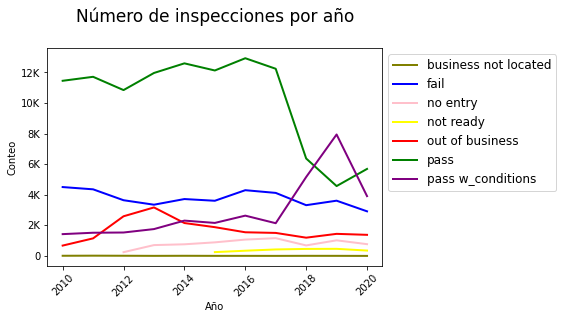

In [50]:
fig, ax = plt.subplots()
plt.plot('year','business not located', data=pivot_2, color='olive', linewidth=2)
plt.plot('year', 'fail', data=pivot_2, color='blue', linewidth=2)
plt.plot('year', 'no entry', data=pivot_2, color='pink', linewidth=2)
plt.plot('year', 'not ready', data=pivot_2, color='yellow', linewidth=2)
plt.plot('year', 'out of business', data=pivot_2, color='red', linewidth=2)
plt.plot('year', 'pass', data=pivot_2, color='green', linewidth=2)
plt.plot('year', 'pass w_conditions', data=pivot_2, color='purple', linewidth=2)
plt.title('Número de inspecciones por año\n', size = 17)
plt.ylabel('Conteo')
plt.xlabel('Año')
plt.xticks(rotation=45)
ax.yaxis.set_major_formatter(FuncFormatter(number_formatter))
aux = plt.legend(bbox_to_anchor=(1, 1), fontsize = 12)

Notemos que a lo largo de los años de estudio se ha presentando un nivel base (similar para todos los años) para los distintos tipos de resultado tras la inspección a excepción del resultado "**Pass**" y "**Pass w_Conditions**", los cuales disminuyeron y aumentaron, respectivamente, después del año 2017.

In [51]:
data['month_label'] = data['month'].apply(lambda x: calendar.month_name[x])
pivot_2 = data
pivot_2 = pivot_2[['results', 'month_label', 'ones']]\
         .groupby(['results', 'month_label']).sum().reset_index()
pivot_2 = pivot_2.pivot(index='month_label', columns='results', values='ones')
pivot_2 = pd.DataFrame(pivot_2)
pivot_2.reset_index(inplace=True)

Ordenamos en relación al mes (Enero, Febrero, Marzo, ..., Diciembre)

In [52]:
pivot_2 = pivot_2.iloc[[4, 3, 7, 0, 8, 6, 5, 1, 11, 10, 9, 2], :]

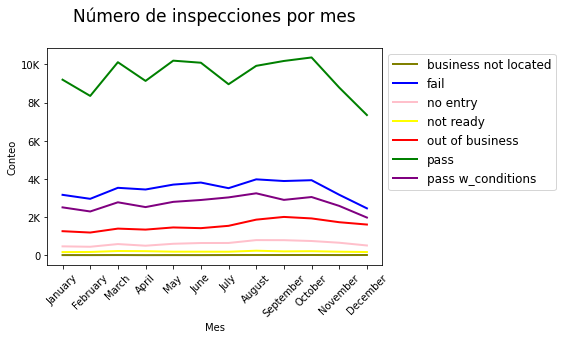

In [53]:
fig, ax=plt.subplots()
plt.plot('month_label','business not located', data=pivot_2, color='olive', linewidth=2)
plt.plot('month_label', 'fail', data=pivot_2, color='blue', linewidth=2)
plt.plot('month_label', 'no entry', data=pivot_2, color='pink', linewidth=2)
plt.plot('month_label', 'not ready', data=pivot_2, color='yellow', linewidth=2)
plt.plot('month_label', 'out of business', data=pivot_2, color='red', linewidth=2)
plt.plot('month_label', 'pass', data=pivot_2, color='green', linewidth=2)
plt.plot('month_label', 'pass w_conditions', data=pivot_2, color='purple', linewidth=2)
plt.title('Número de inspecciones por mes\n', size = 17)
plt.ylabel('Conteo')
plt.xlabel('Mes')
plt.xticks(rotation=45)
ax.yaxis.set_major_formatter(FuncFormatter(number_formatter))
aux = plt.legend(bbox_to_anchor=(1, 1), fontsize = 12)

Al agrupar los negocios en relación al mes bajo el cual fueron inspeccionadas a lo largo de todos los años de estudio, notamos que se ha presentado un mismo nivel base (muy similar para todos los meses) a excepción del resultado "**Pass**", el cual ha tenido fluctuaciones. Cabe mencionar que dichas fluctuaciones no son muy drásticas, a excepción de los meses de Octubre a Diciembre, en donde, disminuye de manera significativa.